In [1]:
# data 전처리 df_preprocessing이 너무 길어져서 옮김
#TODO
# mp3 정렬 -> progress에 존재하는 노래 가사 data에서 추출 후 이를 다시 progress로
# mr 버전 제거
# 가수별 노래 개수 확인 후 10개 미만인 가수의 노래 필터링
# tsv 변환

In [6]:
import pandas as pd
progress_f = 'progress.csv'
data_f = 'data/tab_removed.columns_removed.tsv'
data = pd.read_csv(data_f, sep='\t')
progress = pd.read_csv(progress_f).drop('Unnamed: 0',axis = 1)

In [10]:
data.head(10)

,titles,artist,lyrics,video_name
0,널 볼때마다,강균성 (노을),왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...,/content/drive/MyDrive/data/svs/music/[King of...
1,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),바람 불어와 내 맘 흔들면 지나간 세월에 두 눈을 감아본다 나를 스치는 고요한 떨...,/content/drive/MyDrive/data/svs/music/애절함의 대명사...
2,다 지난 일인데 (Feat.타블로),강균성 (노을),생각 없이 아무렇지 않은 듯이 너를 보냈었어 예 시간은 널 쉽게 데려가 줄 거라고 ...,/content/drive/MyDrive/data/svs/music/강균성(kang...
3,그대 나와 같다면 (Feat. 박기영),강균성 (노을),한번쯤 그대를 바랬나 봐요 습관처럼 눈물이 나요 온종일 그대 뒷모습만 보다 사랑해 ...,/content/drive/MyDrive/data/svs/music/노을 2015 ...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),창 밖으로 하나 둘씩 별빛이 꺼질 때쯤이면 하늘에 편지를 써 날 떠나 다른 사람...,/content/drive/MyDrive/data/svs/music/[King of...
5,처음 그 날처럼,강균성 (노을),가야 한다고 어쩔 수 없다고 너의 손잡은 채 나는 울고만 있었지 언젠가는 꼭 돌아올...,/content/drive/MyDrive/data/svs/music/강균성-이번엔 ...
6,사랑은 언제나 목마르다,강균성 (노을),그렇게 많이 사랑한다 했는데 이제야 사랑을 알 것 같아요 부탁이 있어 제발 용서...,/content/drive/MyDrive/data/svs/music/다 지난 일인데...
7,이번엔 달라,강균성 (노을),이번엔 달라 가슴이 하는 말 너만 보면 숨이 멎어와 벅찬 심장소리만 너만은 달라 내...,/content/drive/MyDrive/data/svs/music/그대 나와 같다...
8,그대 없는 날들,강균성 (노을),끝이라는 그대 거짓말에 아무 말도 슬퍼할 수도 없던 그 날이 믿지 않았었던 그 날이...,/content/drive/MyDrive/data/svs/music/십자가 밑에 나...
9,십자가 밑에 나가,강균성 (노을),주님 내 안에 계시네 말로 표현할 수 없는 기쁨 평안 사랑 절대 빼앗기지 않으리 ...,/content/drive/MyDrive/data/svs/music/펀치 OST 강...


In [8]:
progress.head(10)

,titles,artist,video_name
0,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...
1,사랑은 언제나 목마르다,강균성 (노을),/content/drive/MyDrive/data/svs/music/애절함의 대명사...
2,널 볼때마다,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성(kang...
3,처음 그 날처럼,강균성 (노을),/content/drive/MyDrive/data/svs/music/노을 2015 ...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...
5,이번엔 달라,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성-이번엔 ...
6,다 지난 일인데 (Feat.타블로),강균성 (노을),/content/drive/MyDrive/data/svs/music/다 지난 일인데...
7,그대 나와 같다면 (Feat. 박기영),강균성 (노을),/content/drive/MyDrive/data/svs/music/그대 나와 같다...
8,십자가 밑에 나가,강균성 (노을),/content/drive/MyDrive/data/svs/music/십자가 밑에 나...
9,그대 없는 날들,강균성 (노을),/content/drive/MyDrive/data/svs/music/펀치 OST 강...


In [9]:
lyrics = []
for p_title,p_artist in zip(progress['titles'],progress['artist']):
    for f_title, f_artist, lyric in zip(data['titles'],data['artist'],data['lyrics']):
        if p_title == f_title and p_artist == f_artist:
            lyrics.append(lyric)

In [11]:
progress['lyrics'] = pd.Series(lyrics)

In [12]:
progress.head()

,titles,artist,video_name,lyrics
0,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,바람 불어와 내 맘 흔들면 지나간 세월에 두 눈을 감아본다 나를 스치는 고요한 떨...
1,사랑은 언제나 목마르다,강균성 (노을),/content/drive/MyDrive/data/svs/music/애절함의 대명사...,그렇게 많이 사랑한다 했는데 이제야 사랑을 알 것 같아요 부탁이 있어 제발 용서...
2,널 볼때마다,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성(kang...,왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...
3,처음 그 날처럼,강균성 (노을),/content/drive/MyDrive/data/svs/music/노을 2015 ...,가야 한다고 어쩔 수 없다고 너의 손잡은 채 나는 울고만 있었지 언젠가는 꼭 돌아올...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,창 밖으로 하나 둘씩 별빛이 꺼질 때쯤이면 하늘에 편지를 써 날 떠나 다른 사람...


In [13]:
progress.to_csv('data/lyrics_alinged_tab_removed.tsv',index=False,header=None,sep='\t')

In [10]:
#MR 모두 제거 해야함
import pandas as pd
progress = pd.read_csv('data/lyrics_alinged_tab_removed.tsv',sep = '\t')
progress.head()

,titles,artist,video_name,lyrics
0,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,바람 불어와 내 맘 흔들면 지나간 세월에 두 눈을 감아본다 나를 스치는 고요한 떨...
1,사랑은 언제나 목마르다,강균성 (노을),/content/drive/MyDrive/data/svs/music/애절함의 대명사...,그렇게 많이 사랑한다 했는데 이제야 사랑을 알 것 같아요 부탁이 있어 제발 용서...
2,널 볼때마다,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성(kang...,왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...
3,처음 그 날처럼,강균성 (노을),/content/drive/MyDrive/data/svs/music/노을 2015 ...,가야 한다고 어쩔 수 없다고 너의 손잡은 채 나는 울고만 있었지 언젠가는 꼭 돌아올...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,창 밖으로 하나 둘씩 별빛이 꺼질 때쯤이면 하늘에 편지를 써 날 떠나 다른 사람...


In [14]:
index = []
for num,video_name in enumerate(progress['video_name']):
    if 'TJ노래방' in video_name or 'TJ 노래방' in video_name or '금영' in video_name or 'MR' in video_name or 'mr' in video_name:
        print(progress.iloc[num])
        index.append(num)

                               우연이
video_name    /content/drive/MyDrive/data/svs/music/[KY 금영노래...
lyrics        내 통장에서 당신 통장으로  내사랑을 부쳐 드립니다 보고플땐 언제나 찾아쓰세요  넉...
Name: 13021, dtype: object
titles                                                  아리쓰리아리랑
artist                                                      윤수현
video_name    /content/drive/MyDrive/data/svs/music/[TJ노래방  ...
lyrics        헤일 수 없이 수많은 밤을  내 가슴 도려내는 아픔에 겨워  얼마나 울었던가 동백아...
Name: 13028, dtype: object
titles                                                       편지
artist                                                      이진아
video_name    /content/drive/MyDrive/data/svs/music/[TJ노래방] ...
lyrics        밤바다 무작정 기차 타고 떠났던 너와 둘만이 밤하늘 보았던 그 여름밤 아름다웠지 너...
Name: 13166, dtype: object
titles                                           이제 나만 믿어요 (MR)
artist                                                      임영웅
video_name    /content/drive/MyDrive/data/svs/music/[TJ노래방] ...
lyrics        사랑이었을까 날 스쳐 지나간 그 이름 그리고 그 순간들은 난 거기 있

In [15]:
len(index)

418

In [11]:
import pandas as pd
progress_f = 'data/progress.csv'
data_f = 'data/f_result.csv'
data = pd.read_csv(data_f).drop(['Unnamed: 0','Unnamed: 0.1'],axis =1)
progress = pd.read_csv(progress_f).drop('Unnamed: 0',axis = 1)

In [28]:
progress.head()

,titles,artist,video_name
0,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...
1,사랑은 언제나 목마르다,강균성 (노을),/content/drive/MyDrive/data/svs/music/애절함의 대명사...
2,널 볼때마다,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성(kang...
3,처음 그 날처럼,강균성 (노을),/content/drive/MyDrive/data/svs/music/노을 2015 ...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...


In [29]:
data.head()

,titles,artist,lyrics,video_name
0,널 볼때마다,강균성 (노을),왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...,/content/drive/MyDrive/data/svs/music/[King of...
1,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),바람 불어와 내 맘 흔들면 지나간 세월에 두 눈을 감아본다 나를 스치는 고요한 떨...,/content/drive/MyDrive/data/svs/music/애절함의 대명사...
2,다 지난 일인데 (Feat.타블로),강균성 (노을),생각 없이 아무렇지 않은 듯이 너를 보냈었어 예 시간은 널 쉽게 데려가 줄 거라고 ...,/content/drive/MyDrive/data/svs/music/강균성(kang...
3,그대 나와 같다면 (Feat. 박기영),강균성 (노을),한번쯤 그대를 바랬나 봐요 습관처럼 눈물이 나요 온종일 그대 뒷모습만 보다 사랑해 ...,/content/drive/MyDrive/data/svs/music/노을 2015 ...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),창 밖으로 하나 둘씩 별빛이 꺼질 때쯤이면 하늘에 편지를 써 날 떠나 다른 사람...,/content/drive/MyDrive/data/svs/music/[King of...


In [30]:
lyrics = []
for p_title,p_artist in zip(progress['titles'],progress['artist']):
    for f_title, f_artist, lyric in zip(data['titles'],data['artist'],data['lyrics']):
        if p_title == f_title and p_artist == f_artist:
            lyrics.append(lyric)

In [31]:
progress['lyrics'] = pd.Series(lyrics)
progress.head()

,titles,artist,video_name,lyrics
0,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,바람 불어와 내 맘 흔들면 지나간 세월에 두 눈을 감아본다 나를 스치는 고요한 떨...
1,사랑은 언제나 목마르다,강균성 (노을),/content/drive/MyDrive/data/svs/music/애절함의 대명사...,그렇게 많이 사랑한다 했는데 이제야 사랑을 알 것 같아요 부탁이 있어 제발 용서...
2,널 볼때마다,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성(kang...,왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...
3,처음 그 날처럼,강균성 (노을),/content/drive/MyDrive/data/svs/music/노을 2015 ...,가야 한다고 어쩔 수 없다고 너의 손잡은 채 나는 울고만 있었지 언젠가는 꼭 돌아올...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,창 밖으로 하나 둘씩 별빛이 꺼질 때쯤이면 하늘에 편지를 써 날 떠나 다른 사람...


In [32]:
progress.to_csv('data/lyrics_alinged_tab_removed.tsv',index=False,header=None,sep='\t')

In [33]:
#MR 모두 제거 해야함
import pandas as pd
progress = pd.read_csv('data/lyrics_alinged_tab_removed.tsv',sep = '\t')
progress.head()

,titles,artist,video_name,lyrics
0,바람기억 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,바람 불어와 내 맘 흔들면 지나간 세월에 두 눈을 감아본다 나를 스치는 고요한 떨...
1,사랑은 언제나 목마르다,강균성 (노을),/content/drive/MyDrive/data/svs/music/애절함의 대명사...,그렇게 많이 사랑한다 했는데 이제야 사랑을 알 것 같아요 부탁이 있어 제발 용서...
2,널 볼때마다,강균성 (노을),/content/drive/MyDrive/data/svs/music/강균성(kang...,왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...
3,처음 그 날처럼,강균성 (노을),/content/drive/MyDrive/data/svs/music/노을 2015 ...,가야 한다고 어쩔 수 없다고 너의 손잡은 채 나는 울고만 있었지 언젠가는 꼭 돌아올...
4,내 눈물 모아 (웃는 얼굴에 수박씨),강균성 (노을),/content/drive/MyDrive/data/svs/music/[King of...,창 밖으로 하나 둘씩 별빛이 꺼질 때쯤이면 하늘에 편지를 써 날 떠나 다른 사람...


In [34]:
index = []
for num,video_name in enumerate(progress['video_name']):
    if 'TJ노래방' in video_name or 'TJ 노래방' in video_name or '금영' in video_name or 'MR' in video_name or 'mr' in video_name:
        print(progress.iloc[num])
        index.append(num)

                               우연이
video_name    /content/drive/MyDrive/data/svs/music/[KY 금영노래...
lyrics        첫눈에 맘에 든 그 남자 오늘 밤 난 너를 찍었어 뜨거운 미소마저도 다가갈 수 있다...
Name: 13021, dtype: object
titles                                                  아리쓰리아리랑
artist                                                      윤수현
video_name    /content/drive/MyDrive/data/svs/music/[TJ노래방  ...
lyrics        아리아리 아리랑 마음이 너무 아려 쓰리쓰리 쓰리랑 가슴이 너무 쓰려 꽃 다운 내 사...
Name: 13028, dtype: object
titles                                                       편지
artist                                                      이진아
video_name    /content/drive/MyDrive/data/svs/music/[TJ노래방] ...
lyrics        여전히 남아있는  잔잔한 글씨들이 내 맘을 내 눈빛을 움직이네 살며시 꽃송이를 전해...
Name: 13166, dtype: object
titles                                           이제 나만 믿어요 (MR)
artist                                                      임영웅
video_name    /content/drive/MyDrive/data/svs/music/[TJ노래방] ...
lyrics        무얼 믿은 걸까 부족했던 내게서  나조차 못 믿던 내게 여태 머문 사

In [35]:
len(index)

418

In [36]:
print(index)

[60, 69, 120, 121, 127, 130, 134, 189, 206, 234, 262, 290, 292, 320, 348, 363, 450, 454, 455, 467, 591, 625, 717, 800, 829, 940, 941, 956, 958, 969, 971, 975, 976, 979, 981, 983, 1092, 1098, 1145, 1148, 1163, 1166, 1194, 1195, 1197, 1235, 1243, 1258, 1259, 1266, 1287, 1384, 1401, 1406, 1432, 1492, 1495, 1673, 1696, 1728, 1744, 1852, 1909, 1963, 2046, 2047, 2062, 2069, 2071, 2072, 2159, 2183, 2196, 2204, 2441, 2581, 2618, 2637, 2646, 2667, 2668, 2676, 2680, 2681, 2694, 2699, 2703, 2707, 2709, 2713, 2725, 2748, 2755, 2763, 2826, 2865, 2885, 2971, 2974, 3134, 3151, 3252, 3256, 3257, 3258, 3351, 3361, 3365, 3366, 3404, 3415, 3424, 3427, 3432, 3672, 3738, 3764, 3772, 3833, 3840, 3846, 3853, 3865, 3881, 3892, 3899, 3923, 3956, 4075, 4080, 4154, 4230, 4251, 4353, 4394, 4408, 4411, 4420, 4484, 4508, 4559, 4561, 4574, 4575, 4589, 4630, 4643, 4688, 4689, 4705, 4726, 4757, 4929, 4942, 4950, 4961, 5016, 5127, 5156, 5184, 5280, 5310, 5327, 5364, 5542, 5554, 5629, 5679, 5703, 5820, 5860, 5952, 5961,

In [37]:
MR_del_data = progress.drop(index = index)

In [39]:
MR_del_data.to_csv('data/Mr_removed.lyrics_alinged.tab_removed.tsv',index=False,header=None,sep='\t')

In [47]:
import pandas as pd
from pprint import pprint as pp

appropriate = []
artist_counter = {}

for i in range(len(MR_del_data)):
    try:
        artist_counter[MR_del_data.iloc[i]['artist']] += 1
    except:
        artist_counter[MR_del_data.iloc[i]['artist']] = 1

song_count = 0
singer_count = 0
with open('data/singer_list.txt','w',encoding='UTF-8') as f:
    for key,value in artist_counter.items():
        if value > 40:
            appropriate.append(key)
            print(str(value) + " " + key)
            f.write(str(value) + " " + key+'\n')
            song_count += value
            singer_count += 1
print(song_count)
print(singer_count)
#
#    f.writelines(song_count)

49 정동하
41 알리 (ALi)
51 방탄소년단
42 한영애
46 강성훈
69 윤종신
47 김호중
44 플라이 투 더 스카이
62 MC몽
45 유영진
53 성시경
42 권인하
58 박효신
47 박상민
44 김건모
41 이효리
50 김경호
61 아이유
43 김동률
42 김민종
45 김범수
42 The One (더원)
63 임영웅
50 영탁
44 윤건
43 서영은
48 볼빨간사춘기
42 김진호 (SG워너비)
45 린
43 김혁건
48 다비치
42 이석훈
45 거미
52 지아
48 윤하 (YOUNHA)
44 기리보이
43 헤이즈 (Heize)
42 넬 (NELL)
48 에픽하이 (EPIK HIGH)
43 노라조
49 케이윌
45 BIGBANG
47 달빛요정 역전만루홈런
50 더보이즈 (THE BOYZ)
45 태연 (TAEYEON)
41 손승연
46 싸이 (PSY)
47 로이킴
41 루시드폴
44 장윤정
42 가비엔제이
47 버즈
45 소향
50 폴킴
42 장범준
41 휘성 (Realslow)
42 신승훈
41 신해철
42 에릭남 (Eric Nam)
41 허각
42 벤
43 황치열
42 정준일
44 왁스
47 임창정
45 이승환
45 이승기
43 박혜경
52 이찬원
42 임태경
45 혁오 (HYUKOH)
41 양수경
41 엄정화
44 조항조
47 진해성
44 홍대광
44 DAY6 (데이식스)
41 KCM
44 SE7EN
42 최진희
43 나희경
46 심규선 (Lucia)
42 적우
44 이미자
41 서문탁
45 제이세라
41 안예슬
41 웅산
4006
88


TypeError: unsupported operand type(s) for +: 'int' and 'str'

In [49]:
data_list = MR_del_data[MR_del_data['artist'].isin(appropriate)]

print(data_list.head())
data_list.to_csv('data/singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,header=None,sep='\t') 

                 titles    artist  \
34  아름다운 강산 (With. 민영기)       정동하   
38              아름다운 강산  알리 (ALi)   
40                 팔도강산     방탄소년단   
42    ...라구요 (원곡가수 강산에)       한영애   
43  아껴둔 이야기 (Full Ver.)       강성훈   

                                           video_name  \
34  /content/drive/MyDrive/data/svs/music/불후의명곡 Im...   
38  /content/drive/MyDrive/data/svs/music/알리 - 아름다...   
40  /content/drive/MyDrive/data/svs/music/BTS - Pa...   
42  /content/drive/MyDrive/data/svs/music/[ROCK] 강...   
43  /content/drive/MyDrive/data/svs/music/강성훈   아껴...   

                                               lyrics  
34  하늘은 파랗게 구름은 하얗게 실바람도 불어와 부풀은 내 마음 나뭇잎 푸르게 강물도 ...  
38  하늘은 파랗게 / 구름은 하얗게 실바람도 불어와 / 부풀은 내 마음 나뭇잎 푸르게 ...  
40  Yo once again  Bighit Represent  우리는 방탄소년단  Le...  
42  두만강 푸른 물에 노 젓는 뱃사공을  볼 수는 없었지만  그 노래만은 너무 잘 아는...  
43  아직도 그대로인지 시간이 데려간 니모습 힘이 들어도 나의 하나까지도 아껴주는지 저녁...  


In [52]:
unused_data = MR_del_data.drop(index = MR_del_data[MR_del_data['artist'].isin(appropriate)].index)
print(unused_data.head())
unused_data.to_csv('data/singer_under40.tsv',index=False,header=None,sep='\t')

                 titles    artist  \
0     바람기억 (웃는 얼굴에 수박씨)  강균성 (노을)   
1          사랑은 언제나 목마르다  강균성 (노을)   
2                널 볼때마다  강균성 (노을)   
3              처음 그 날처럼  강균성 (노을)   
4  내 눈물 모아 (웃는 얼굴에 수박씨)  강균성 (노을)   

                                          video_name  \
0  /content/drive/MyDrive/data/svs/music/[King of...   
1  /content/drive/MyDrive/data/svs/music/애절함의 대명사...   
2  /content/drive/MyDrive/data/svs/music/강균성(kang...   
3  /content/drive/MyDrive/data/svs/music/노을 2015 ...   
4  /content/drive/MyDrive/data/svs/music/[King of...   

                                              lyrics  
0  바람 불어와 내 맘 흔들면 지나간 세월에  두 눈을 감아본다 나를 스치는 고요한 떨...  
1  그렇게 많이 사랑한다 했는데  이제야 사랑을 알 것 같아요  부탁이 있어 제발 용서...  
2  왜 이렇게 힘들죠 나에겐 익숙한 일인데 조금씩 비틀거려요 갑자기 왜 화가 나려고 하...  
3  가야 한다고 어쩔 수 없다고 너의 손잡은 채 나는 울고만 있었지 언젠가는 꼭 돌아올...  
4  창 밖으로 하나 둘씩  별빛이 꺼질 때쯤이면  하늘에 편지를 써 날 떠나 다른 사람...  


In [5]:
#4/22
import pandas as pd

ipa_f = 'data/test_ipa2.txt'
data_f = 'data/singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv'

data = pd.read_csv(data_f,sep='\t')

In [6]:
data.head()

,titles,artist,video_name,lyrics
0,아름다운 강산 (With. 민영기),정동하,/content/drive/MyDrive/data/svs/music/불후의명곡 Im...,하늘은 파랗게 구름은 하얗게 실바람도 불어와 부풀은 내 마음 나뭇잎 푸르게 강물도 ...
1,아름다운 강산,알리 (ALi),/content/drive/MyDrive/data/svs/music/알리 - 아름다...,하늘은 파랗게 / 구름은 하얗게 실바람도 불어와 / 부풀은 내 마음 나뭇잎 푸르게 ...
2,팔도강산,방탄소년단,/content/drive/MyDrive/data/svs/music/BTS - Pa...,Yo once again Bighit Represent 우리는 방탄소년단 Le...
3,...라구요 (원곡가수 강산에),한영애,/content/drive/MyDrive/data/svs/music/[ROCK] 강...,두만강 푸른 물에 노 젓는 뱃사공을 볼 수는 없었지만 그 노래만은 너무 잘 아는...
4,아껴둔 이야기 (Full Ver.),강성훈,/content/drive/MyDrive/data/svs/music/강성훈 아껴...,아직도 그대로인지 시간이 데려간 니모습 힘이 들어도 나의 하나까지도 아껴주는지 저녁...


In [10]:
with open(ipa_f,'r',encoding='utf-8') as f:
    ipa_lyrics = f.readlines()
print(ipa_lyrics)

uɫtɛqɐdʑimɐn puthɐqijɐ tɕoqɯmmɐn dʌ nʌɾɯɫ poɫ su itke mjʌtʃhiɫdʑʌn ujʌnhi poɐttʌn tɕithɯn hwɐdʑɐŋɯj tʃhwihɐn nemosɯp sumqiqo siphɯn to dɐɾɯn sɐlmi ittɐmjʌn ʌndʑeqɐdʑi moɾɯntʃhʌq hɐɫthende hɐnbʌnmɐn dwedoljʌ tɕuɫsunɯn ʌpkenni ʌtʌtkhe idɛɾo sɐɾɐŋi qɯnnɐni hɛŋbokhɛttʌn tʃhʌɯmɯɾo doɾɐqɐɫ su itke hʌɾɐkhɛdʑwʌ nʌdo ɡiʌkhɐni sumi mʌtɕɯɫ dɯt sɐɾɐŋhɛttʌn qumbodɐdo dʌ ɐɾɯmdɐwʌ pusʌdʑiɫqʌt ɡɐttʌn nunbusin sunqɐndɯɫ ɡiʌkho nɐɫ duqo tʌnɐjɐ hɐndɐmjʌn tʃhuʌqi nunmuɾi dweʌjɐ hɐndɐmjʌn puthɐqijɐ tɕoqɯmmɐn dʌ nʌɾɯɫ poɫsuitke \n', 'nɛqen iɾʌniɫ ʌpsɯɫqʌɾɐ midko sɐɾɐsʌttɕjo nʌmu ʌɾisʌqkedo hɐɾudʑoŋiɫ nɐn mʌŋhɐni hɐnɯɫmɐn pɐɾɐboqe dwɛttɕjo ɡɯɾʌtkhe dwenqʌdʑjo nɐɾɯɫ noɯɫsun ʌpsɯɫqʌɾɐ ɡɯdɛɫ midʌsʌttɕjo tɕʌŋmɐɫ pɐbotʃhʌɾʌm nɐn nɐɾi ɡɐɫsuɾoq tɕɐqu ɡɯdɛ mosɯp tʌolɐ nɛnune hɐnɯɾɯɫ dɐmqettɕjo ɡɯ nuqudo ɡɯdɛiɫ sun ʌptɐqo puttɕɐpnɯn nɐ nʌmu ʌsɛkhɐqettɕjo tɕʌŋmɐɫ ɡɯ hɯnhɐn sɐɾɐŋhɐndɐn mɐɫdʑotʃhɐ hɛdʑudʑi mosɐn nɐɾɯɫ ɡɯnjɐŋ mɐɯmqʌt jokhɛjo ɡɯdɛɫ tɕɐptɕinɯn ɐnɯɫqʌɾɐ ɡɯdɛn midʌtkettɕjo tɕʌŋmɐɫ ɡɯɾɛsʌnnɐjo nɐɾiqɐɫsuɾoq tɕ

In [11]:
len(ipa_lyrics)

4006

In [12]:
ipa_lyrics[0]

'hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾɐmdo puɾʌwɐ puphuɾɯn nɛ mɐɯm nɐmunnip phuɾɯqe ɡɐŋmuɫdo phuɾɯqe ɐɾɯmdɐun iqose nɛqɐ itko neqɐ inne uɾinɯn i tɐŋ wie uɾinɯn thɛʌnɐqo ɐɾɯmdɐun iqose tɕɐɾɐŋsɯɾʌn iqose sɐliɾɐ tʃhɐnɾɐnhɐqe pinnɐnɯn pulɡɯn thɛjɐŋi pitʃhuqo hɐjɐn muɫqjʌɫ nʌmtʃhinɯn tɕʌ pɐdɐwɐ hɐmqe inne ɡɯ ʌɫmɐnɐ tɕoɯnqɐ uɾi sɐnɯn iqose sɐɾɐŋhɐnɯn ɡɯdɛwɐ noɾɛhɐɾi pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm onɯɫdo nʌɾɯɫ mɐnnɐɾʌ ɡɐjɐdʑi mɐɫhɛjɐdʑi mʌn hunnɐɾe nʌwɐ nɐ sɐɫqo tɕiqo jʌŋwʌnhɐn iqose uɾiɯj sɛ qumɯɫ mɐndɯɾʌ poqophɐ tʃhɐnɾɐnhɐqe pinnɐnɯn pulɡɯn thɛjɐŋi pitʃhuqo hɐjɐn muɫqjʌɫ nʌmtʃhinɯn tɕʌ pɐdɐwɐ hɐmqe inne ɡɯ ʌɫmɐnɐ tɕoɯnqɐ uɾi sɐnɯn iqose sɐɾɐŋhɐnɯn ɡɯdɛwɐ sɐɾɐŋhɐmjʌ noɾɛhɐɾi pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm oooo pomjʌɾɯmi tɕinɐmjʌn ɡɐɯɫ ɡjʌuɾi ondɐne ɐɾɯmdɐun ɡɐŋsɐn nʌɯj mɐɯmɯn nɐɯj mɐɯm nɐɯj mɐɯmɯn nʌɯj 

In [14]:
ipa_lyrics = [i.replace('\n','') for i in ipa_lyrics]

In [15]:
ipa_lyrics[0]

'hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾɐmdo puɾʌwɐ puphuɾɯn nɛ mɐɯm nɐmunnip phuɾɯqe ɡɐŋmuɫdo phuɾɯqe ɐɾɯmdɐun iqose nɛqɐ itko neqɐ inne uɾinɯn i tɐŋ wie uɾinɯn thɛʌnɐqo ɐɾɯmdɐun iqose tɕɐɾɐŋsɯɾʌn iqose sɐliɾɐ tʃhɐnɾɐnhɐqe pinnɐnɯn pulɡɯn thɛjɐŋi pitʃhuqo hɐjɐn muɫqjʌɫ nʌmtʃhinɯn tɕʌ pɐdɐwɐ hɐmqe inne ɡɯ ʌɫmɐnɐ tɕoɯnqɐ uɾi sɐnɯn iqose sɐɾɐŋhɐnɯn ɡɯdɛwɐ noɾɛhɐɾi pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm onɯɫdo nʌɾɯɫ mɐnnɐɾʌ ɡɐjɐdʑi mɐɫhɛjɐdʑi mʌn hunnɐɾe nʌwɐ nɐ sɐɫqo tɕiqo jʌŋwʌnhɐn iqose uɾiɯj sɛ qumɯɫ mɐndɯɾʌ poqophɐ tʃhɐnɾɐnhɐqe pinnɐnɯn pulɡɯn thɛjɐŋi pitʃhuqo hɐjɐn muɫqjʌɫ nʌmtʃhinɯn tɕʌ pɐdɐwɐ hɐmqe inne ɡɯ ʌɫmɐnɐ tɕoɯnqɐ uɾi sɐnɯn iqose sɐɾɐŋhɐnɯn ɡɯdɛwɐ sɐɾɐŋhɐmjʌ noɾɛhɐɾi pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm pɐmpɐbɐmpɐbɐm pɐbɐbɐm pɐbɐbɐm pɐmpɐ pɐbɐbɐbɐbɐbɐm oooo pomjʌɾɯmi tɕinɐmjʌn ɡɐɯɫ ɡjʌuɾi ondɐne ɐɾɯmdɐun ɡɐŋsɐn nʌɯj mɐɯmɯn nɐɯj mɐɯm nɐɯj mɐɯmɯn nʌɯj 

In [16]:
data['lyrics'] = pd.Series(ipa_lyrics)
data.head()

,titles,artist,video_name,lyrics
0,아름다운 강산 (With. 민영기),정동하,/content/drive/MyDrive/data/svs/music/불후의명곡 Im...,hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾɐmdo ...
1,아름다운 강산,알리 (ALi),/content/drive/MyDrive/data/svs/music/알리 - 아름다...,hɐnɯɾɯn phɐɾɐtkhe slaʃ ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾ...
2,팔도강산,방탄소년단,/content/drive/MyDrive/data/svs/music/BTS - Pa...,jəʊ wʌns ɐɡɛn bɪɡhɪt ɹɛpɹɪzɛnt uɾinɯn pɐŋthɐns...
3,...라구요 (원곡가수 강산에),한영애,/content/drive/MyDrive/data/svs/music/[ROCK] 강...,dumɐnqɐŋ phuɾɯn muɾe no tɕʌnnɯn pɛtsɐqoŋɯɫ poɫ...
4,아껴둔 이야기 (Full Ver.),강성훈,/content/drive/MyDrive/data/svs/music/강성훈 아껴...,ɐdʑiqto ɡɯdɛɾoindʑi siqɐni deɾjʌqɐn nimosɯp hi...


In [17]:
data.to_csv('data/ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,header=None,sep='\t')

In [18]:
group_singer = ['방탄소년단','플라이 투 더 스카이','다비치','에픽하이 (EPIK HIGH)','노라조','BIGBANG','더보이즈 (THE BOYZ)','가비엔제이','DAY6 (데이식스)']

data = data.drop(index = data[data['artist'].isin(group_singer)].index)

In [20]:
len(data)

3591

In [21]:
ta.to_csv(,''data/group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv'ndex=False,header=None,sep='\t')

In [1]:
#4/23 26 28
import pandas as pd
import unicodedata

In [2]:
data = pd.read_csv('data/group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep = '\t')

In [3]:
data.tail()

,titles,artist,video_name,lyrics
3586,바람,헤이즈 (Heize),/content/drive/MyDrive/data/svs/music/【韓中字】 He...,aɪ dʒʌst wɒntɪd tuː pleɪ ðɪs ɡeɪm sɐɾɐŋiɾɐn ɡɐ...
3587,키키키 (With MIIII),벤,/content/drive/MyDrive/data/svs/music/MIIII & ...,khikhikhikhikhi khikhikhikhikhi nɐnɯn khido tɕ...
3588,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,/content/drive/MyDrive/data/svs/music/사랑해 행복해 ...,sɐɾɐmdɯɾɯn ɡɯdʑʌ somthʌɫmuŋtʃhi sɐɾɐmdɯɾɯn tɕi...
3589,꾸러기 (Groggy),김범수,/content/drive/MyDrive/data/svs/music/꾸러기 (Gro...,ɡɐbjʌun noŋdɐmɯɾo sɐɾɐŋɯɫ tɕikhiɫ sun ʌpsʌ him...
3590,알아 (Feat. HYNN(박혜원)),MC몽,/content/drive/MyDrive/data/svs/music/알아 (I Kn...,ɐɾɐ ɐɾɐ ɐmu mɐɫdo hɐdʑi mɐ ɐnjɐ ɐnjɐ ɐmu mɐɫdo...


In [7]:
c = 0
with open('data/mismatch1.txt','w',encoding='utf-8') as f:
    wrong = []
    for title,v_name in zip(data['titles'],data['video_name']):
        cnt = 0
        t = title
        if '(' in title:
            t = title.split('(')[0]
        t = unicodedata.normalize('NFC',t.replace(' ','').replace("'",'').replace(',','').lower())
        v_name = v_name[38:]
        v_name = unicodedata.normalize('NFC',v_name.replace(' ','').replace("'",'').replace(',','').lower())
        for letter in t:
            if letter in v_name:
                cnt += 1
            
        if len(t) - cnt >=1:
            wrong.append(t)
            c += 1
            f.write(title+'|'+v_name+'\n')
            print(title + '|' + v_name)
    print(len(wrong))
    print(c)

So Da (笑多)|강성훈아껴둔이야기(가사첨부).mp3
환란과 핍박중에도(383장)|새찬송가336장(통383)환난과핍박중에도.mp3
안녕|[0]만약에-권인하원곡반주가사.mp3
사랑 그리고 우린…|권인하➿사랑그리고우린(가사).mp3
슬픈 영혼의 아리아 [엘리제]|김경호슬픈영혼의아리아(엘리제)(가사첨부).mp3
내게 남은 사랑을 드릴께요|김경호내게남은사랑을드릴게요.mp3
Replay|kimdongryul(김동률)_답장(reply)(가사).mp3
여행|출발-김동률(가사).mp3
나를 보내야|endlesslove-김민종withlyrics.mp3
후회 왕|윤종신-후회王(vocal김연우).mp3
전화해줘|♪sg워너비-내사람[가사lyrics].mp3
친구에게|김진호(sg워너비)-편의점앞에서가사.mp3
북촌고백|김진호(sgwannabe)-고백.mp3
집에 가는 길|씨야(seeya)집으로돌아오는길(feat김진호sg워너비)(가사첨부).mp3
얼음물|김진호(sgwannabe)-고백.mp3
샤랄라|sgwannabe-lalala(colorcodedlyricshanromeng).mp3
티비|그거모으러왔나봐요-김진호(sg워너비)music사랑👇가사첨부.mp3
더크로스의 해체|더크로스1집앨범전곡듣기더크로스김혁건tv[가사자막]korsub.mp3
돈 크라이의 탄생|더크로스-dontcry(가사듣기3699fa).mp3
두려워 말라|【옥타브요기요】김혁건나만의그대(warrior)전구간옥타브확인가사보기!!.mp3
2012년 3월 26일|04partiii(however)락밴드크로스legend더크로스김혁건tv[가사자막]korsub.mp3
세상의로의 초대|【옥타브요기요】김혁건나만의그대(warrior)전구간옥타브확인가사보기!!.mp3
악성댓글|【옥타브요기요】김혁건나만의그대(warrior)전구간옥타브확인가사보기!!.mp3
경추야 놀자|유성은(usungeun)-야놀자(rightontime)(가사hanromeng).mp3
새로운 도전 대학원|김혁건솔로warrior-07jeeny더크로스김혁건tv[가사자막].mp3
사

In [24]:
with open('data/mismatch1.txt','r',encoding='utf-8') as f:
    with open('data/match_from_mismatch.txt','r',encoding='utf-8') as d:
        a = f.readlines()
        b = d.readlines()
        b = [i.strip() for i in b]

        appropriate = [ a[int(i) - 1] for i in b if i]
        non_appropriate = [song.split('|')[0] for song in a if song not in appropriate]
        print(non_appropriate)

['So Da (笑多)', '안녕', 'Replay', '여행', '나를 보내야', '전화해줘', '친구에게', '북촌고백', '집에 가는 길', '얼음물', '샤랄라', '티비', '더크로스의 해체', '돈 크라이의 탄생', '두려워 말라', '2012년 3월 26일', '세상의로의 초대', '악성댓글', '경추야 놀자', '새로운 도전 대학원', '사고후 첫앨범', '재능기부', '강연가 김혁건', '인트로', '이제 일년', '너의 노래', '나는 개', '남자의 눈물', '화신 (花信)', 'My Bro (Feat. MC몽,Crown J,허우진,프라임,인태,미료,여정,보행,효진)', '모두에게 크리스마스', 'In The Still Of The Night (with 빅마마, 거미, 세븐) -feat.서재호', '마지막 민물장어의 꿈 2018', '지금', '오늘까지', '사람들', '노래샘', '사나이 (Bonus Track)', '너에게 가는길 (슬램덩크)', 'My Bro (Feat. MC몽, Crown J, 허우진, 프라임, 인태, 미료, 여정, 보행, 효진)', 'Interview', "I Don't Miss You", '내곁에 머물수없니', '비오는 오후에', '…사랑했잖아…', '고마울뿐야', '보라빛 엽서', '비오는 날의 수채화', '혼자있으면', 'The Moment I Saw You (처음 만난 날처럼)', '꿈에', '공 (2012 Ver.)', '여름 찬가 (Feat. MC 하하)', '주르륵', '하늘에서 (부제: 편지)', '안녕 (Duet With 거미)', '알아', '비누 Duet With 김예림', 'Voce (With Roberto Menescal)', '동화 (CF - 한일건설 유앤아이아파트 김하늘편)', 'Reality (원빈, 신민아의 맥심 TOP 광고 삽입곡)', '꿈에 (성대천하 유아독존 동방불패)', '세움', '말로 하지 않아도 (Inst.)', '오늘도 눈물', '사랑은 차가운 유혹 (2016 Ver.)'

In [28]:
non_appropriate_df = data[data['titles'].isin(non_appropriate)]
non_appropriate_df.head()

,titles,artist,video_name,lyrics
11,So Da (笑多),강성훈,/content/drive/MyDrive/data/svs/music/강성훈 아껴...,sesɐŋ qʌdʑiɫ ɡʌt ɡɐthɯn ɡiphɯn nʌɯj hɐn sum tɕ...
80,안녕,권인하,/content/drive/MyDrive/data/svs/music/[0] 만약에 ...,sɐɾɐŋ sɐɾɐŋ ɡɯ iɾɯmmɐnɯɾo dɐqɐsʌmjʌn ɡɯ mɐnkhɯ...
182,Replay,김동률,/content/drive/MyDrive/data/svs/music/KIM DONG...,nɐn jodʑɯm ɡɐqɯm tɐn sesɐŋe ittɕi nʌɫ tʌnɐbonɛ...
207,여행,김동률,/content/drive/MyDrive/data/svs/music/출발 - 김동률...,ʌndʑenɐ ɡɯ nophɯn hwesɛqpiɫdiŋ soqe dɐlidɯt tɕ...
246,나를 보내야,김민종,/content/drive/MyDrive/data/svs/music/Endless ...,nɐeqen ʌndʑenɐ muqʌun tɕimi dweʌsʌ idʑen nɐɫ n...


In [29]:
non_appropriate_df.tail()

,titles,artist,video_name,lyrics
3488,Playlist,태연 (TAEYEON),/content/drive/MyDrive/data/svs/music/TAEYEON ...,lɪsən tuː maɪ feɪvəɹɪt sɒŋ ɡɐtɕhi dɯdko siphʌs...
3504,바람,한영애,/content/drive/MyDrive/data/svs/music/한영애 ➿ ...,sumɐnɯn siqɐni tɕinɐqɐdo nɯɫ ɡɐthɯn tɕɐɾie inn...
3533,따오기,한영애,/content/drive/MyDrive/data/svs/music/한영애 ➿ ...,poiɫdɯsi poiɫdɯsi poidʑi ɐnnɯn tɐoq tɐoq tɐoqs...
3583,바람처럼,한영애,/content/drive/MyDrive/data/svs/music/바람 한영애(가...,sumɐnɯn siqɐni tɕinɐqɐdo nɯɫ ɡɐthɯn tɕɐɾie inn...
3586,바람,헤이즈 (Heize),/content/drive/MyDrive/data/svs/music/【韓中字】 He...,aɪ dʒʌst wɒntɪd tuː pleɪ ðɪs ɡeɪm sɐɾɐŋiɾɐn ɡɐ...


In [34]:
appropriate_data = data.drop(index = non_appropriate_df.index)
appropriate_data.head()

,titles,artist,video_name,lyrics
0,아름다운 강산 (With. 민영기),정동하,/content/drive/MyDrive/data/svs/music/불후의명곡 Im...,hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾɐmdo ...
1,아름다운 강산,알리 (ALi),/content/drive/MyDrive/data/svs/music/알리 - 아름다...,hɐnɯɾɯn phɐɾɐtkhe slaʃ ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾ...
2,...라구요 (원곡가수 강산에),한영애,/content/drive/MyDrive/data/svs/music/[ROCK] 강...,dumɐnqɐŋ phuɾɯn muɾe no tɕʌnnɯn pɛtsɐqoŋɯɫ poɫ...
3,아껴둔 이야기 (Full Ver.),강성훈,/content/drive/MyDrive/data/svs/music/강성훈 아껴...,ɐdʑiqto ɡɯdɛɾoindʑi siqɐni deɾjʌqɐn nimosɯp hi...
4,My Girl,강성훈,/content/drive/MyDrive/data/svs/music/❤My Girl...,wəʊ huː jɛh heɪ heɪ seɪ maɪ dɹiːmz kʌm tɹuː ma...


In [35]:
appropriate_data.to_csv('data/rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,header=None,sep='\t')

In [42]:
from pprint import pprint
artist_counter = {}
for artist in non_appropriate_df['artist']:
    try:
        artist_counter[artist] += 1
    except:
        artist_counter[artist] = 1
pprint(artist_counter)

{'KCM': 1,
 'MC몽': 3,
 'SE7EN': 2,
 '강성훈': 1,
 '권인하': 3,
 '김동률': 2,
 '김민종': 1,
 '김진호 (SG워너비)': 9,
 '김혁건': 12,
 '나희경': 1,
 '달빛요정 역전만루홈런': 4,
 '박상민': 2,
 '박혜경': 3,
 '박효신': 1,
 '볼빨간사춘기': 1,
 '성시경': 1,
 '손승연': 2,
 '신해철': 2,
 '안예슬': 3,
 '알리 (ALi)': 1,
 '양수경': 1,
 '엄정화': 2,
 '에릭남 (Eric Nam)': 2,
 '영탁': 1,
 '웅산': 3,
 '유영진': 3,
 '윤종신': 1,
 '이석훈': 1,
 '이승환': 1,
 '이찬원': 1,
 '이효리': 1,
 '임영웅': 1,
 '임태경': 2,
 '적우': 2,
 '정준일': 1,
 '제이세라': 1,
 '조항조': 1,
 '최진희': 2,
 '태연 (TAEYEON)': 2,
 '폴킴': 1,
 '한영애': 3,
 '헤이즈 (Heize)': 1,
 '휘성 (Realslow)': 4}


In [44]:
len(appropriate_data)

3498

In [5]:
from mutagen.mp3 import MP3
audio = MP3("C:/Users/Lee/Downloads/[ 가사  Lyrics ] 장범준 - 주홍빛거리.mp3")

HeaderNotFoundError: can't sync to MPEG frame

In [7]:
import librosa
audio_path = "C:/Users/Lee/Downloads/accompaniment.wav"
y,sr = librosa.load(audio_path) 

In [ ]:
#from colab
import librosa
import pandas as pd
import os
import glob

data = pd.read_csv('rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')
data.head()

saved_path = '/content/drive/MyDrive/data/svs/appropriate_data/'
for index,video_name in enumerate(data['video_name']):
  video_path = saved_path + video_name[38:]
  data['video_name'][index] = video_name[38:-4]

data.tail()

data.to_csv('path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,header=None,sep='\t')

saved_path = '/content/drive/MyDrive/data/svs/appropriate_data/'
for video_name in data['video_name']:
  saved_video_path = saved_path + video_name +'.mp3'
  save_video_path = saved_path + video_name + '.wav'
  try:
    os.rename(saved_video_path,save_video_path)
  except:
    pass

files = glob.glob('/content/drive/MyDrive/data/svs/appropriate_data/*.wav')
len(files)

data = pd.read_csv('feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')
data.tail()

from pprint import pprint
video_counter = {}
for video_name in data['video_name']:
  try:
    video_counter[video_name] +=1
  except:
    video_counter[video_name] = 1
for key,value in video_counter.items():
  if value>1:
    print(key+'\t'+str(value))

import re
pattern = re.compile('with\s{0,}[ㄱ-ㅎ|ㅏ-ㅣ|가-힣]')

removal_index = []
for index,x in enumerate(zip(data['title'],data['video_name'])):
  title,v_name = x
  #if 'with' in title.lower() or 'with' in v_name.lower():
  if pattern.search(title.lower()) is not None or pattern.search(v_name.lower()) is not None or 'duet' in title.lower() or 'duet' in v_name.lower():
    removal_index.append(index)
    print(title+'_'+v_name)
print(len(removal_index))

del removal_index[11]
print(removal_index)

zduet_rm_data = removal_index



duet_rm_data = data.drop(index=removal_index)
duet_rm_data.tail()

len(duet_rm_data)

from pprint import pprint
video_counter = {}
for video_name in feat_rm_data['video_name']:
  try:
    video_counter[video_name] +=1
  except:
    video_counter[video_name] = 1
for key,value in video_counter.items():
  if value>1:
    print(key+'\t'+str(value))

duet_rm_data.to_csv('duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,header=None,sep='\t')

data = pd.read_csv('duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')
data.tail()

from pprint import pprint
video_counter = {}
for video_name in data['video_name']:
  try:
    video_counter[video_name] +=1
  except:
    video_counter[video_name] = 1
for key,value in video_counter.items():
  if value>1:
    print(key+'\t'+str(value))

import re

removal_index = []
for index,x in enumerate(zip(data['title'],data['video_name'])):
  title,v_name = x
  #if 'with' in title.lower() or 'with' in v_name.lower():
  if 'live' in title.lower() or 'live' in v_name.lower():
    removal_index.append(index)
    print(title+'_'+v_name)
print(len(removal_index))

live_rm_data = data.drop(index=removal_index)
len(live_rm_data)

live_rm_data.to_csv('live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')



In [1]:
import pandas as pd
data = pd.read_csv('data/live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')
data.tail()

,Unnamed: 0,title,artist,video_name,lyric
2991,3006,불어오라 바람아,한영애,불어오라 바람아 Blow Wind Blow,idʑenɯn modu doɾɐqɐ tɕedʑɐɾie ɐnnɯndɐ puɫthɐnɯ...
2992,3007,봄,한영애,봄,jʌnbunhoŋ tʃhimɐqɐ pom pɐɾɐme hwinɐlidʌɾɐ onɯɫ...
2993,3008,키키키 (With MIIII),벤,MIIII & Ben (Bebe Mignon) - 키키키 (Ki Ki Ki),khikhikhikhikhi khikhikhikhikhi nɐnɯn khido tɕ...
2994,3009,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사랑해 행복해 (Prod By 선우정아X안신애 (바버렛츠)) I Love You B...,sɐɾɐmdɯɾɯn ɡɯdʑʌ somthʌɫmuŋtʃhi sɐɾɐmdɯɾɯn tɕi...
2995,3010,꾸러기 (Groggy),김범수,꾸러기 (Groggy),ɡɐbjʌun noŋdɐmɯɾo sɐɾɐŋɯɫ tɕikhiɫ sun ʌpsʌ him...


In [4]:
data = data.drop(columns= 'Unnamed: 0')
data.head()

,title,artist,video_name,lyric
0,아름다운 강산,알리 (ALi),알리 - 아름다운 강산 [불후의 명곡2 전설을 노래하다Immortal Songs 2...,hɐnɯɾɯn phɐɾɐtkhe slaʃ ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾ...
1,...라구요 (원곡가수 강산에),한영애,[ROCK] 강산에 - 라구요 │ 가사포함,dumɐnqɐŋ phuɾɯn muɾe no tɕʌnnɯn pɛtsɐqoŋɯɫ poɫ...
2,아껴둔 이야기 (Full Ver.),강성훈,강성훈 아껴둔 이야기(가사 첨부),ɐdʑiqto ɡɯdɛɾoindʑi siqɐni deɾjʌqɐn nimosɯp hi...
3,My Girl,강성훈,❤My Girl 강성훈 [가사첨부],wəʊ huː jɛh heɪ heɪ seɪ maɪ dɹiːmz kʌm tɹuː ma...
4,영원히,강성훈,강성훈 영원히 (가사 첨부),wɛn aɪ lɒst ɪn maɪ hɑːt ʌɾjʌpke uttʌn ni mosɯp...


In [10]:
data.to_csv('data/live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,sep='\t')

In [1]:
#5/9
import pandas as pd

In [2]:
data = pd.read_csv('data/duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')
data.tail()

,title,artist,video_name,lyric
2919,불어오라 바람아,한영애,불어오라 바람아 Blow Wind Blow,idʑenɯn modu doɾɐqɐ tɕedʑɐɾie ɐnnɯndɐ puɫthɐnɯ...
2920,봄,한영애,봄,jʌnbunhoŋ tʃhimɐqɐ pom pɐɾɐme hwinɐlidʌɾɐ onɯɫ...
2921,키키키 (With MIIII),벤,MIIII & Ben (Bebe Mignon) - 키키키 (Ki Ki Ki),khikhikhikhikhi khikhikhikhikhi nɐnɯn khido tɕ...
2922,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사랑해 행복해 (Prod By 선우정아X안신애 (바버렛츠)) I Love You B...,sɐɾɐmdɯɾɯn ɡɯdʑʌ somthʌɫmuŋtʃhi sɐɾɐmdɯɾɯn tɕi...
2923,꾸러기 (Groggy),김범수,꾸러기 (Groggy),ɡɐbjʌun noŋdɐmɯɾo sɐɾɐŋɯɫ tɕikhiɫ sun ʌpsʌ him...


In [3]:
seperation_mark_data_list = data[['title','artist']]
seperation_mark_data_list.tail()

,title,artist
2919,불어오라 바람아,한영애
2920,봄,한영애
2921,키키키 (With MIIII),벤
2922,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM
2923,꾸러기 (Groggy),김범수


In [4]:
seperation_mark_data_list.to_csv('data/for_crawl_seperation_mark_dat_list.csv',index=False,sep='\t')

In [2]:
#5/13
import pandas as pd
import math

In [3]:
melone_data = pd.read_csv('data/for_seperation_mark.melone_result.csv').drop(columns = ['Unnamed: 0'])
genie_data = pd.read_csv('data/for_seperation_mark.genie_result.csv').drop(columns = ['Unnamed: 0'])
print(len(melone_data))
print(len(genie_data))
melone_data.tail()


2836
2697


,titles,artist,lyrics
2831,나비의 겨울,박효신,시간을 멈출수 있다면 온힘을 다해 막을텐데 어쩌면 우리 오늘이 마지막인데 잠시후면 ...
2832,그대안의 블루,임영웅,난 난 눈을 감아요 빛과 그대 모습 사라져 이제 어둠이 밀려오네 저 파란 어둠 속에...
2833,사랑한 걸로 됐어요,박효신,아무런 걱정하지 말아요 나 하나 없다고 이 세상이 바뀌진 않아 참을 수 없이 아픈 ...
2834,키키키 (With MIIII),벤,키키키키키 키키키키키 나는 키도 작고 예쁘진 않지만 노래는 잘 불러 나는 키는 크...
2835,꾸러기 (Groggy),김범수,가벼운 농담으로 사랑을 지킬 순 없어 힘든 바램인가 싶어 curious 니가 준 사...


In [15]:
genie_data.tail()

,titles,artist,lyrics
2692,편지,임태경,여기까지가 끝인가보오%이제 나는 돌아서겠소%억지 노력으로 인연을 거슬러%괴롭히지는 ...
2693,인연 (원곡가수 이선희),소향,약속해요 %이 순간이 다 지나고 %다시 보게 %되는 그날 %모든 걸 버리고 %그대 ...
2694,고백,김진호 (SG워너비),NaN
2695,Endless,강성훈,NaN
2696,폭죽과 별,김진호 (SG워너비),NaN


In [34]:
melone_data[melone_data.isna().any(axis=1)]

,titles,artist,lyrics
66,무조건 사랑,권인하,NaN
201,그 때마다,김민종,NaN
1428,친구야,조항조,NaN
1781,Angel,SE7EN,NaN
2410,I Love You,웅산,NaN


In [35]:
genie_data[genie_data.isna().any(axis=1)]

,titles,artist,lyrics
7,...라구요 (원곡가수 강산에),한영애,NaN
1818,은하수(恩하受)_큰 사랑을 얻다,강성훈,NaN
2597,Now,김경호,NaN
2657,언젠가,김진호 (SG워너비),NaN
2680,가족사진 (2020),김진호 (SG워너비),NaN
2688,졸업사진,김진호 (SG워너비),NaN
2694,고백,김진호 (SG워너비),NaN
2695,Endless,강성훈,NaN
2696,폭죽과 별,김진호 (SG워너비),NaN


In [4]:
cnt = 0
final_lyrics = []
for m_data,g_data in zip(melone_data['lyrics'],genie_data['lyrics']):
    
    if g_data is None or math.isnan(g_data):
        final_lyrics.append(m_data)
        continue
    if m_data is None or math.isnan(m_data):
        final_lyrics.append(g_data)
        continue

    print(g_data)
    m_sep_cnt =  m_data.count('%')
    g_sep_cnt =  g_data.count('%')
    
    if abs(m_sep_cnt - g_sep_cnt) > 10:
        cnt += 1
print(cnt)

TypeError: must be real number, not str

In [4]:
cnt = 0
final_lyrics = []
for m_data in melone_data.iterrows():
    m_data = m_data[1]
    g_data = genie_data[(genie_data['titles'] == m_data['titles']) & (genie_data['artist'] == m_data['artist'])]
    
    if len(g_data) == 0:
        final_lyrics.append(m_data['lyrics'])
        continue
    
    try:
        if math.isnan(m_data['lyrics']):
            final_lyrics.append(g_data.iloc[0]['lyrics'])
            continue
    except:
        pass
    
    try:
        if math.isnan(g_data.iloc[0]['lyrics']):
            final_lyrics.append(m_data['lyrics'])
            continue
    except:
        pass

    m_sep_cnt = m_data['lyrics'].count('%')
    
    g_sep_cnt = g_data.iloc[0]['lyrics'].count('%')
    
    if m_sep_cnt > g_sep_cnt:
        final_lyrics.append(m_data['lyrics'])
    else:
        final_lyrics.append(g_data.iloc[0]['lyrics'])


In [57]:
genie_data[(genie_data['titles'] == 'My Love') & (genie_data['artist'] == '강성ㅎ')]

TypeError: tuple indices must be integers or slices, not str

In [62]:
print(type('강성훈'))
artist = m_data['artist']
type(artist)

<class 'str'>


TypeError: tuple indices must be integers or slices, not str

In [29]:
type(m_data)

pandas.core.series.Series

In [45]:
len(final_lyrics)

2836

In [5]:
melone_data['lyrics'] = pd.Series(final_lyrics)
melone_data.head()

,titles,artist,lyrics
0,보이지 않는 인사,강성훈,이제야 울어요%아파서 우네요%떠나가는 그댈 보며%보이지 않는 인사 전해요%고운 그대...
1,아름다운 강산,알리 (ALi),하늘은 파랗게 구름은 하얗게%실바람도 불어와 부풀은 내 마음%나뭇잎 푸르게 강물도 ...
2,축복,강성훈,"강은경 작사, 심상원 작곡 %알아 이제는 오지 않겠죠 %그 동안 너무 행복했어요 %..."
3,영원히,강성훈,"유나 작사, 송재준 작곡 %When I lost in my heart %내가 슬픔에..."
4,My Girl,강성훈,wo hoo yeah hey %say my dream come true %ho my...


In [6]:
data = melone_data
cnt = 0
for lyric in data['lyrics']:
    if '작사' in lyric or '작곡' in lyric:
        cnt += 1

print(cnt)

14


In [7]:
data.to_csv('data/mg_seperation_mark.tsv')

In [10]:
cnt = 0
result = []
data = pd.read_csv('data/mg_seperation_mark.tsv',sep='\t')
for lyric in data['lyrics']:
    if '%' not in lyric:
        cnt += 1
        result.append(lyric)
print(cnt)

261


In [11]:
result[2]

'미안해 하지 말아요 혼자 남게 되겠죠 괜찮아요 그대 언제나 기다릴께요 이대로 간직할께요 지난 날은 가슴에 담아둘께요 그대는 알겠죠 난 그대뿐이죠 수많은 날이 흘러가도 내안엔 그대만 가득한 거죠 보고싶겠죠 많이 울겠죠 언젠간 나도 지쳐가겠죠 내 걱정말아요 편하게 지내요 그대를 위해서라면 난 어떤것도 참을테니까 조금씩 잊어가겠죠 그래서 나는 없겠죠 하지만 난 그대를 원망 안해요 세상은 말이죠 나 원하는 대로 모든걸 주진 않나봐요 그대도 마찬가진 것 같아요 보고싶겠죠 많이 울겠죠 언젠간 나도 지쳐가겠죠 내 걱정말아요 편하게 지내요 그대를 위해서라면 난 어떤것도 참을테니까 뒤돌아 보아요 들리지 않나요 아직도 그대 부르잖아요 대답은 없겠죠 나 바보 같겠죠 그래도 세상 가득한건 나의 사랑 그대니까   '

In [14]:
#5/15
import pandas as pd

In [15]:
data = pd.read_csv('data/m_data.csv')
data.tail()

,Unnamed: 0,titles,artist,lyrics
2833,2833,그대안의 블루,임영웅,난 난 눈을 감아요%빛과 그대 모습 사라져%이제 어둠이 밀려오네%저 파란 어둠 속에...
2834,2834,"BSK Street (Narr.슈퍼창따이, G.NA)",김범수,웰컴 투 뉴욕~!%예~%뉴욕 시리~! 뉴욕시리!%야 와 우리가 뉴욕을 왔어.%저게 ...
2835,2835,키키키 (With MIIII),벤,키키키키키%키키키키키%나는 키도 작고 예쁘진 않지만 %노래는 잘 불러%나는 키는 크...
2836,2836,꾸러기 (Groggy),김범수,가벼운 농담으로%사랑을 지킬 순 없어%힘든 바램인가 싶어 curious%니가 준 사...
2837,2837,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사람들은 그저 솜털뭉치%사람들은 지나치듯 우리가%솜털덩어리라 말하죠%네네네 %하지만...


In [16]:
cnt = 0
nan_cnt = 0
for l in data['lyrics']:
    try:
        if '%' not in l:
            cnt += 1
    except:
        nan_cnt += 1
        
print(nan_cnt)
print(cnt)

5
6


In [17]:
#nan 제거 하기
#5/16
import pandas as pd
import math

In [7]:
melon_data = pd.read_csv('data/m_data.csv').drop(columns = ['Unnamed: 0'])
genie_data = pd.read_csv('data/for_seperation_mark.genie_result.csv').drop(columns = ['Unnamed: 0'])

In [9]:
melon_data.tail()

,titles,artist,lyrics
2833,그대안의 블루,임영웅,난 난 눈을 감아요%빛과 그대 모습 사라져%이제 어둠이 밀려오네%저 파란 어둠 속에...
2834,"BSK Street (Narr.슈퍼창따이, G.NA)",김범수,웰컴 투 뉴욕~!%예~%뉴욕 시리~! 뉴욕시리!%야 와 우리가 뉴욕을 왔어.%저게 ...
2835,키키키 (With MIIII),벤,키키키키키%키키키키키%나는 키도 작고 예쁘진 않지만 %노래는 잘 불러%나는 키는 크...
2836,꾸러기 (Groggy),김범수,가벼운 농담으로%사랑을 지킬 순 없어%힘든 바램인가 싶어 curious%니가 준 사...
2837,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사람들은 그저 솜털뭉치%사람들은 지나치듯 우리가%솜털덩어리라 말하죠%네네네 %하지만...


In [10]:
genie_data.tail()

,titles,artist,lyrics
2692,편지,임태경,여기까지가 끝인가보오%이제 나는 돌아서겠소%억지 노력으로 인연을 거슬러%괴롭히지는 ...
2693,인연 (원곡가수 이선희),소향,약속해요 %이 순간이 다 지나고 %다시 보게 %되는 그날 %모든 걸 버리고 %그대 ...
2694,고백,김진호 (SG워너비),NaN
2695,Endless,강성훈,NaN
2696,폭죽과 별,김진호 (SG워너비),NaN


In [18]:
cnt = 0
final_lyrics = []
for m_data in melon_data.iterrows():
    m_data = m_data[1]
    g_data = genie_data[(genie_data['titles'] == m_data['titles']) & (genie_data['artist'] == m_data['artist'])]
    
    if len(g_data) == 0:
        final_lyrics.append(m_data['lyrics'])
        continue
    
    try:
        if math.isnan(m_data['lyrics']):
            final_lyrics.append(g_data.iloc[0]['lyrics'])
            continue
    except:
        pass
    
    try:
        if math.isnan(g_data.iloc[0]['lyrics']):
            final_lyrics.append(m_data['lyrics'])
            continue
    except:
        pass

    m_sep_cnt = m_data['lyrics'].count('%')
    
    g_sep_cnt = g_data.iloc[0]['lyrics'].count('%')
    
    if m_sep_cnt > g_sep_cnt:
        final_lyrics.append(m_data['lyrics'])
    else:
        final_lyrics.append(g_data.iloc[0]['lyrics'])


In [19]:
len(final_lyrics)

2838

In [21]:
for index,l in enumerate(final_lyrics):
    if '%' not in l:
        print(index)

2725


In [23]:
print(final_lyrics[2725])

가사 정보가 없습니다.


In [24]:
for index,l in enumerate(final_lyrics):
    if l.count('%') < 3:
        print(index)

2725


In [25]:
seperation_data = melon_data
seperation_data['lyrics'] = pd.Series(final_lyrics)
seperation_data.tail()

,titles,artist,lyrics
2833,그대안의 블루,임영웅,난 난 눈을 감아요%빛과 그대 모습 사라져%이제 어둠이 밀려오네%저 파란 어둠 속에...
2834,"BSK Street (Narr.슈퍼창따이, G.NA)",김범수,웰컴 투 뉴욕~!%예~%뉴욕 시리~! 뉴욕시리!%야 와 우리가 뉴욕을 왔어.%저게 ...
2835,키키키 (With MIIII),벤,키키키키키%키키키키키%나는 키도 작고 예쁘진 않지만 %노래는 잘 불러%나는 키는 크...
2836,꾸러기 (Groggy),김범수,가벼운 농담으로 %사랑을 지킬 순 없어 %힘든 바램인가 싶어 curious?%니가 ...
2837,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사람들은 그저 솜털뭉치%사람들은 지나치듯 우리가%솜털덩어리라 말하죠%네네네 %하지만...


In [28]:
seperation_data.to_csv('data/with_seperation.duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.singer_up40.mr_removed.lyrics_alinged.tab_removed',index=False,sep='\t')

In [1]:
#05/17
import pandas as pd

In [7]:
with open('data/seperation_mark_2ipa.txt','r',encoding='utf-8') as f:
    lyrics = f.readlines()
    lyrics = [l.strip() for l in lyrics]
    print(len(lyrics))

2838


In [10]:
data = pd.read_csv('data/with_seperation.duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')
data.tail()

,titles,artist,lyrics
2833,그대안의 블루,임영웅,난 난 눈을 감아요%빛과 그대 모습 사라져%이제 어둠이 밀려오네%저 파란 어둠 속에...
2834,"BSK Street (Narr.슈퍼창따이, G.NA)",김범수,웰컴 투 뉴욕~!%예~%뉴욕 시리~! 뉴욕시리!%야 와 우리가 뉴욕을 왔어.%저게 ...
2835,키키키 (With MIIII),벤,키키키키키%키키키키키%나는 키도 작고 예쁘진 않지만 %노래는 잘 불러%나는 키는 크...
2836,꾸러기 (Groggy),김범수,가벼운 농담으로 %사랑을 지킬 순 없어 %힘든 바램인가 싶어 curious?%니가 ...
2837,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사람들은 그저 솜털뭉치%사람들은 지나치듯 우리가%솜털덩어리라 말하죠%네네네 %하지만...


In [11]:
data['lyrics'] = pd.Series(lyrics)
data.tail()

,titles,artist,lyrics
2833,그대안의 블루,임영웅,nɐn nɐn nunɯɫ ɡɐmɐjo %pitkwɐ ɡɯdɛ mosɯp sɐɾɐdʑ...
2834,"BSK Street (Narr.슈퍼창따이, G.NA)",김범수,weɫkhʌm thu njujoqtɪldə %je tɪldə %njujoq siɾi...
2835,키키키 (With MIIII),벤,khikhikhikhikhi %khikhikhikhikhi %nɐnɯn khido ...
2836,꾸러기 (Groggy),김범수,ɡɐbjʌun noŋdɐmɯɾo %sɐɾɐŋɯɫ tɕikhiɫ sun ʌpsʌ %h...
2837,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,sɐɾɐmdɯɾɯn ɡɯdʑʌ somthʌɫmuŋtʃhi %sɐɾɐmdɯɾɯn tɕ...


In [13]:
data.to_csv('data/2ipa.with_seperation.duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,sep='\t')

In [9]:
#05/21
import librosa
import os
import matplotlib.pyplot as plt
import numpy as np
import librosa.display

(4876288,)
-0.33963645


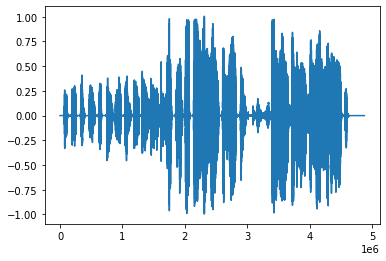

In [10]:
voice, sr= librosa.load('C:/Users/Lee/Downloads/vocals (2).wav',sr=22050)
# voice) type:numpy.ndarray shape : (4876288,)
print(voice.shape)

print(voice[3876288])
plt.plot(voice)
plt.show()

In [11]:
mel_spectogram = librosa.feature.melspectrogram(y = voice,sr = 22050,n_fft=1024, hop_length=256)

In [7]:
print(mel_spectogram)

[[0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 ...
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]
 [0. 0. 0. ... 0. 0. 0.]]


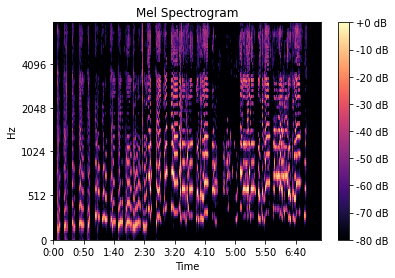

In [8]:
mel_spect = librosa.power_to_db(mel_spectogram, ref=np.max)
librosa.display.specshow(mel_spect, y_axis='mel', fmax=8000, x_axis='time')
plt.title('Mel Spectrogram')
plt.colorbar(format='%+2.0f dB')

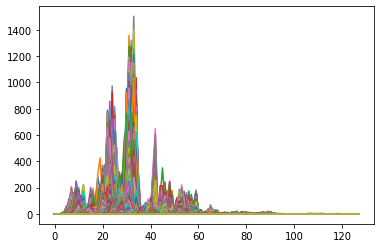

In [13]:
plt.plot(mel_spectogram)
plt.show()

In [14]:
mel_spectogram.shape

(128, 19049)

In [20]:
for i in range(128):
    print(mel_spectogram[i][10000])

9.932565e-08
4.403965e-09
5.915935e-10
2.542948e-10
6.9911743e-10
1.389933e-09
4.6635834e-10
2.9610994e-10
4.0047846e-10
2.754838e-10
3.067086e-10
4.986798e-10
3.852647e-10
1.8010934e-10
1.218948e-10
5.9635014e-10
7.4216494e-10
2.1267778e-10
1.7148404e-11
4.2731513e-11
1.0609694e-10
1.119959e-09
2.315188e-09
9.803051e-10
1.0375697e-08
1.0388411e-08
1.0452297e-09
1.1064842e-09
7.5802087e-10
1.5568016e-09
8.804253e-09
8.988438e-09
9.422906e-10
9.044776e-10
2.787955e-09
3.418474e-09
4.342732e-09
1.5699737e-08
1.3237543e-08
1.1605442e-08
1.06837895e-07
1.305368e-07
3.3732146e-08
2.5564082e-08
2.2133674e-08
2.9034286e-08
1.8438278e-08
4.7273833e-08
3.3552453e-08
2.1065736e-08
1.2956449e-09
5.6835125e-10
8.7265883e-10
2.7340646e-10
8.820808e-11
2.2503854e-10
5.472081e-10
5.8803923e-10
1.0204064e-10
2.1031163e-10
2.2382733e-10
2.651544e-10
3.6835485e-10
8.0858203e-10
7.2861017e-10
4.5999035e-10
7.9682216e-10
1.3995477e-09
7.1723244e-10
9.797706e-10
2.979178e-09
4.3510386e-09
1.0867973e-09
6.3

In [6]:
#05/24
import librosa
import matplotlib.pyplot as plt
import librosa.display
import IPython.display

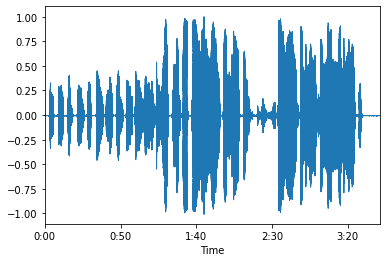

In [5]:
voice, sr= librosa.load('C:/Users/Lee/Downloads/vocals (2).wav',sr=22050)
# voice) type:numpy.ndarray shape : (4876288,)

#mel_spectogram = librosa.feature.melspectrogram(y = voice,sr = 22050,n_fft=1024, hop_length=256)
librosa.display.waveplot(voice, sr=sr)
plt.show()

In [8]:
IPython.display.Audio(voice, rate=sr)

In [1]:
#05/28
import pandas as pd
a = pd.read_csv('data/2ipa.with_seperation.duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',usecols = ['titles','lyrics'],sep='\t')
a.head()

,titles,lyrics
0,영원히,%wɛn aɪ lɒst ɪn maɪ hɑːt %nɛqɐ sɯɫphɯme pɐdʑjʌ...
1,My Love,himdɯɾʌttʌn nɐɯj sɛŋhwɐɫ soqen ʌndʑenɐ %ɡɯdɛn ...
2,...라구요 (원곡가수 강산에),dumɐnqɐŋ phuɾɯn muɾe no tɕʌnnɯn pɛtsɐqoŋɯɫ %po...
3,My Girl,wəʊ huː jɛh heɪ %seɪ maɪ dɹiːm kʌm tɹuː %həʊ m...
4,아름다운 강산,hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe %siɫbɐɾɐmdo...


In [2]:
b = a['lyrics']
b.head()

0    %wɛn aɪ lɒst ɪn maɪ hɑːt %nɛqɐ sɯɫphɯme pɐdʑjʌ...
1    himdɯɾʌttʌn nɐɯj sɛŋhwɐɫ soqen ʌndʑenɐ %ɡɯdɛn ...
2    dumɐnqɐŋ phuɾɯn muɾe no tɕʌnnɯn pɛtsɐqoŋɯɫ %po...
3    wəʊ huː jɛh heɪ %seɪ maɪ dɹiːm kʌm tɹuː %həʊ m...
4    hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe %siɫbɐɾɐmdo...
Name: lyrics, dtype: object

In [8]:
print(b.values[1])

himdɯɾʌttʌn nɐɯj sɛŋhwɐɫ soqen ʌndʑenɐ %ɡɯdɛn nɛqe to dɐɾɯn sesɐŋɯɫ %ʌdke hɛdʑuʌsʌdo %mitʃhʌ podɐphɐdʑi mosɛttʌn %nɐ idʑenɯn dɐŋsinqe mɐɫhɛdʑulɛjo %ɡomɐwʌjo nɛqe hɐŋsɐŋ tɕuʌttʌn mɐɯm %ʌnɯsɛnqɐ qɯt ʌpnɯn joŋqiɾɯɫ %ʌdke hɛdʑuʌsʌttɕjo %nɐdo molɛ tɕʌmdʑʌm khʌdʑinɯn %ɡɯdɛɫ hjɐŋhɐn nɛ ɐnɯj tɕinsiɫdwen sɐɾɐŋ %ʌndʑenqɐnɯn dɐŋsinqe dɯɾiɫ nɐɫ itkettɕjo %nɐmɐnɯj modɯn ɡʌt %jɐqsokhɛjo dɐsiqɯm %nɛ mɐɯm ɡiphɯn sɐɾɐŋɯɫ əʊ beɪbi %jʌŋwʌnhɐn sɐɾɐŋmɐnɯɾo %mɐɯm soq hɐn ɡose nɐmqjʌttɕimɐn %ʌndʑenɐ ɡɐndʑikhɛjo %nɐmɐnɯj ɡɯdɛ %jʌŋwʌnhɐn sɐɾɐŋdweqiɾɯɫ %ɡɯdɛ ɡjʌthe nɐ hɐŋsɐŋ %mʌmuɫqiɫ pɐɾɛjo %jʌŋwʌnhi hɐn ɡose %nɐ idʑenɯn midʌjo %uɾiɯj ɡiphɯn sɐɾɐŋɯɫ əʊ beɪbi %jʌŋwʌnhɐn sɐɾɐŋmɐnɯɾo %mɐɯm soq hɐn ɡose nɐmqjʌttɕimɐn %ʌndʑenɐ ɡɐndʑikhɛjo %nɐmɐnɯj ɡɯdɛ %tɕindʑʌŋ ɡɯdɛɫ sɐɾɐŋhɐɫ ɡʌsɯɫ %dɐsi hɐnbʌn uɾi jɐqsokhɛjo %jʌŋwʌnhi hɐndʑɐɾiɫ tɕikhidʑɐqo %nɐ dɐŋsinqjʌthe hɐŋsɐŋ hɐmqe hɐɫqejo %jʌŋwʌnhɐn sɐɾɐŋ dweqiɾɯɫ %jʌŋwʌnhɐn sɐɾɐŋ maɪ lʌv %%


In [17]:
import pandas as pd
a = ["one","two"]
b = ['asd asdf as g', 'as g gie wwq']

sample_df = pd.DataFrame()
sample_df['titles'] = pd.Series(a) 
sample_df['lyrics'] = pd.Series(b)
sample_df.head()

,titles,lyrics
0,one,asd asdf as g
1,two,as g gie wwq


In [19]:
sample_df.to_csv('C:/workspace/DeepSinger/sample/sample.tsv',index = False,sep = '\t')

In [21]:
pd.read_csv('C:/workspace/DeepSinger/sample/sample.tsv',sep='\t').head()

,titles,lyrics
0,one,asd asdf as g
1,two,as g gie wwq


In [1]:
#6/4
import pandas as pd

In [2]:
lyrics = pd.read_csv('../seperator_edit.2ipa.with_seperation.duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')

In [3]:
lyrics.tail()

,titles,artist,lyrics
2832,그대안의 블루,임영웅,nɐn nɐn nunɯɫ ɡɐmɐjo % pitkwɐ ɡɯdɛ mosɯp sɐɾɐd...
2833,"BSK Street (Narr.슈퍼창따이, G.NA)",김범수,weɫkhʌm thu njujoqtɪldə % je tɪldə % njujoq si...
2834,키키키 (With MIIII),벤,khikhikhikhikhi % khikhikhikhikhi % nɐnɯn khid...
2835,꾸러기 (Groggy),김범수,ɡɐbjʌun noŋdɐmɯɾo % sɐɾɐŋɯɫ tɕikhiɫ sun ʌpsʌ %...
2836,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,sɐɾɐmdɯɾɯn ɡɯdʑʌ somthʌɫmuŋtʃhi % sɐɾɐmdɯɾɯn t...


In [5]:
video = pd.read_csv('./data/duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.ipa.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',sep='\t')

video.tail()

,title,artist,video_name,lyric
2919,불어오라 바람아,한영애,불어오라 바람아 Blow Wind Blow,idʑenɯn modu doɾɐqɐ tɕedʑɐɾie ɐnnɯndɐ puɫthɐnɯ...
2920,봄,한영애,봄,jʌnbunhoŋ tʃhimɐqɐ pom pɐɾɐme hwinɐlidʌɾɐ onɯɫ...
2921,키키키 (With MIIII),벤,MIIII & Ben (Bebe Mignon) - 키키키 (Ki Ki Ki),khikhikhikhikhi khikhikhikhikhi nɐnɯn khido tɕ...
2922,사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠)),KCM,사랑해 행복해 (Prod By 선우정아X안신애 (바버렛츠)) I Love You B...,sɐɾɐmdɯɾɯn ɡɯdʑʌ somthʌɫmuŋtʃhi sɐɾɐmdɯɾɯn tɕi...
2923,꾸러기 (Groggy),김범수,꾸러기 (Groggy),ɡɐbjʌun noŋdɐmɯɾo sɐɾɐŋɯɫ tɕikhiɫ sun ʌpsʌ him...


In [18]:
cnt = 0
for t in lyrics['titles'].values:
    if t not in video['title'].values:
        cnt += 1        

In [19]:
print(cnt)

0


In [12]:
print(len(lyrics['titles'].values))

2837


In [17]:
print(video['title'].values)

['아름다운 강산' '...라구요 (원곡가수 강산에)' '아껴둔 이야기 (Full Ver.)' ...
 '키키키 (With MIIII)' '사랑해 행복해 (Prod. By 선우정아X안신애 (바버렛츠))' '꾸러기 (Groggy)']


In [21]:
video[video['title'] == '아름다운 강산']

,title,artist,video_name,lyric
0,아름다운 강산,알리 (ALi),알리 - 아름다운 강산 [불후의 명곡2 전설을 노래하다Immortal Songs 2...,hɐnɯɾɯn phɐɾɐtkhe slaʃ ɡuɾɯmɯn hɐjɐtkhe siɫbɐɾ...


In [45]:
video_list = []
for row in lyrics.iterrows():
    #print(row[1])
    print(video[video['title'] == row[1]['titles']]['video_name'].values)
    video_list.append(video[video['title'] == row[1]['titles']]['video_name'].values[0])    

n OST)']
['Uhm Jung Hwa (엄정화) - Invitation (초대) Lyrics [Color Coded HanRomEng]']
['엄정화 숨은그림 찾기 (가사 첨부)']
['엄정화 - Poison (가사)']
['틈' '엄정화 틈 (가사 첨부)']
['엄정화 눈동자 (가사 첨부)']
['엄정화 슬픈기대 (가사 첨부)']
['Sad delusion']
['Dreamer' 'DREAMER– Uhm Jung Hwa [Color Coded Lyrics] (ENGROMHAN)']
['엄정화 - 괜찮아요 7집 2001년 가요  Kpop'
 '제이세라J-CERA-괜찮아요! 没事儿 kbs2여자의 비밀(女人的秘密) [ 가사지원]ost part12-J&OTV']
['Uhm Jung-hwa - Scarlet 엄정화 - 스칼릿 Music Camp 19991016']
['Uhm Jung-hwa - Remote control and Nail polish 엄정화 - 리모컨과 매니큐어 Music Camp 19']
['Uhm Jung Hwa(엄정화) - Come 2 Me(컴투미)']
['「죄와벌」 엄정화']
['[kpop]korea best rock & ballad 엄정화 - 널 모를께 (가사)']
['엄정화 스칼렛 (가사 첨부)']
['엄정화  장미의 전쟁 (가사 첨부)']
['왁스(Wax)  🐳  반대로 인 거야    (가사)']
['왁스《WAX》 머니(Money) [가사]']
['Watch Me Move - UHM JUNG HWA [Color Coded Lyrics] (ENGROMHAN)']
['가사영상  왁스 - 부탁해요']
['오빠 !!  - 왁스 WAX -  (가사有)']
['가사영상ㅣ왁스 - 화장을고치고']
['왁스(Wax)  🐳  나를 끝낼 수 있나요     (가사)']
['가사영상  왁스 - 사랑하고 싶어']
['왁스(WAX) - 벌써 일년 (가사)']
['왁스(Wax)  🐳  여자는 사랑을 먹고     (가사)']
['왁스(Wax)  🐳  사랑하기 때문에

In [42]:
len(video_list)

2837

In [46]:
lyrics['video_name'] = pd.Series(video_list)

In [48]:
lyrics.head(50)

,titles,artist,lyrics,video_name
0,영원히,강성훈,% wɛn aɪ lɒst ɪn maɪ hɑːt % nɛqɐ sɯɫphɯme pɐdʑ...,강성훈 영원히 (가사 첨부)
1,My Love,강성훈,himdɯɾʌttʌn nɐɯj sɛŋhwɐɫ soqen ʌndʑenɐ % ɡɯdɛn...,강성훈 My love (가사 첨부)
2,...라구요 (원곡가수 강산에),한영애,dumɐnqɐŋ phuɾɯn muɾe no tɕʌnnɯn pɛtsɐqoŋɯɫ % p...,[ROCK] 강산에 - 라구요 │ 가사포함
3,My Girl,강성훈,wəʊ huː jɛh heɪ % seɪ maɪ dɹiːm kʌm tɹuː % həʊ...,❤My Girl 강성훈 [가사첨부]
4,아름다운 강산,알리 (ALi),hɐnɯɾɯn phɐɾɐtkhe ɡuɾɯmɯn hɐjɐtkhe % siɫbɐɾɐmd...,알리 - 아름다운 강산 [불후의 명곡2 전설을 노래하다Immortal Songs 2...
5,보이지 않는 인사,강성훈,idʑejɐ uɾʌjo % ɐphɐsʌ unejo % tʌnɐqɐnɯn ɡɯdɛɫ ...,강성훈 보이지 않는 인사(해금 ver) (가사 첨부)
6,축복,강성훈,% ɐɾɐ idʑenɯn odʑi ɐnkhettɕjo % ɡɯ doŋɐn nʌmu ...,강성훈 축복 (가사 첨부)
7,아껴둔 이야기 (Full Ver.),강성훈,ɐdʑiqto ɡɯdɛɾoindʑi % siqɐni deɾjʌqɐn nimosɯp ...,강성훈 아껴둔 이야기(가사 첨부)
8,날 웃게 한 사람,강성훈,pjʌɾiɫ ʌpsi hɐɾuqɐ ɡɐqo % ɡɐsɯm twinɯn iɫ hɐnɐ...,[MV] 강성훈 날 웃게 한 사람 (이혼변호사는연애중 OST Part7)
9,변심,강성훈,ɐɫsuʌpnɯn ijudɯlo nʌɾɯɫ ɡidɐɾiɫtɛmɐdɐ % mʌɾʌdʑ...,❤ 변심 강 성훈 [가사첨부]


In [50]:
lyrics.to_csv('data/video_name.seperator_edit.2ipa.with_seperation.duration_filtered.live_rm.duet_rm.feat_rm.path_renamed.rm_missmatch.group_singer_rm.singer_up40.mr_removed.lyrics_alinged.tab_removed.tsv',index=False,sep='\t')